# Question 5

In [27]:
df <- read.csv('data-p2/encoded_filtered_mimic3d.csv')
x <- model.matrix(~ . - 1, data = df[, !names(df) %in% 'LOSdays']) 
x <- scale(x)  # Standardize x to have mean 0 and variance 1
y <- df$LOSdays  # Dependent variable as a vector
y <- scale(y)

In [19]:
set.seed(0) # for replicability
t.A <- 10 # true slope
t.B <- 0 # true intercept
t.sd <- 20 # true noise

In [20]:
likehd <- function(param){
  param <- as.numeric(param)
  a = param[1:(ncol(x))]  # Coefficients
  b = param[length(param) - 1]  # Intercept
  sd = param[length(param)]  # Standard deviation

  # Predicted values
  pred = as.numeric(x %*% a) + b

  # Ensure sd is valid to avoid log(0) or Inf in the likelihood calculation
  if (sd <= 0) {
    return(-Inf)  # Invalid standard deviation, return -Inf
  }

  # Calculate log-likelihood
  singlelikelihoods = dnorm(y, mean = pred, sd = sd, log = TRUE)
  sumll = sum(singlelikelihoods)
  
  # Debug: Print log-likelihood
  print(paste("Log-likelihood:", sumll))
  
  return(sumll)
}

In [21]:
prior <- function(param, lambda = 1) {
  a = param[1:(length(param) - 2)]
  b = param[length(param) - 1]
  sd = param[length(param)]

  # Laplace prior for coefficients
  aprior = sum(dexp(abs(a), rate = lambda, log = TRUE))

  # Normal prior for intercept
  bprior = dnorm(b, mean = t.B, sd = 5, log = TRUE)

  # Ensure sd is valid to avoid returning invalid priors
  if (sd <= 0) {
    return(-Inf)  # Invalid sd, return -Inf
  }

  # Uniform prior for standard deviation
  sdprior = dunif(sd, min = 0, max = 2 * t.sd, log = TRUE)

  # Debug: Print log-prior values
  print(paste("Log-prior a:", aprior, "b:", bprior, "sd:", sdprior))

  return(aprior + bprior + sdprior)
}

In [22]:
posterior <- function(param){
return (likehd(param) + prior(param))
}


In [26]:
proposalfunction <- function(param){ 
return(rnorm(105,mean = param, sd = rep(0.1, 105)))
}

run_metropolis_MCMC <- function(startvalue, iterations){
  num_params <- length(startvalue)  # Number of parameters based on the starting value
  chain = array(dim = c(iterations + 1, num_params))  # Initialize the chain for the correct number of params
  chain[1,] = startvalue  # Set the initial value of the chain
  
  for (i in 1:iterations){
    proposal = proposalfunction(chain[i,])   # Generate a proposal using the current chain value

    # Debug: print intermediate values to ensure calculations are correct
    print("Calculating posterior for proposal:")
    print(proposal)
    post_proposal <- posterior(proposal)  # Calculate posterior for the proposal
    print(post_proposal)
    
    post_chain <- posterior(chain[i,])  # Calculate posterior for the current chain value
    print(post_chain)
    
    probab <- exp(post_proposal - post_chain)  # Metropolis acceptance criterion
    print(probab)  # Check if probab is calculated properly

    # Ensure probab is a scalar value
    probab <- min(probab, 1)  # Probability should be <= 1

    # Accept or reject the proposal based on the probability
    if (runif(1) < probab){
      chain[i + 1,] = proposal   # Accept the proposal
    } else {
      chain[i + 1,] = chain[i,]  # Reject the proposal, keep the current value
    }
  }
  
  return(chain)  # Return the entire MCMC chain
}

# Generate a starting value with 105 parameters
start_value <- runif(105)  # Random initial values for the parameters

# Run the Metropolis-Hastings MCMC with the starting value and 10,000 iterations
chain <- run_metropolis_MCMC(start_value, 10000)

[1] "Calculating posterior for proposal:"
  [1]  0.86592845  0.65351063  0.13680880  0.55952864  0.58817514  0.69439461
  [7]  0.32903594  0.18591589  0.18849287  0.87667879  0.70980658  0.20347859
 [13]  0.82321846  1.00568756  1.15751806  0.92296494  0.26434825  0.96184275
 [19]  0.57760146  0.36263420  0.05147354  0.29268682  0.49777538  0.14964641
 [25]  0.18797661  0.10358805  0.19299072  0.48126877  0.80582599  0.28424433
 [31]  0.14306963  0.66452383  0.68279611  0.69919249  0.15443487  0.78652035
 [37]  0.74113735  0.71072094  0.75158020  0.18413670  0.16761186  0.25500001
 [43]  0.30616789  0.29184173  0.84477153  0.25634707  0.09696252 -0.04966674
 [49]  1.00284329  0.09191750  0.30237123  1.01146866  0.23912180  0.96877956
 [55] -0.07770640  0.57738724  0.07404917  0.59929599  0.94545988  0.16719995
 [61] -0.13483633  0.32651796  0.18028695  0.64690682  0.96267337  0.29836157
 [67]  0.43558700  0.22433044  0.11588691  0.45135935  0.74289789  0.52595964
 [73]  0.47816526  0.2

In [11]:
burnIn = 5000
acceptance = 1-mean(duplicated(chain[-(1:burnIn),]))

In [13]:
print(head(chain[-(1:burnIn), 1]))  # Check the first few values of the chain after burn-in
print(summary(chain[-(1:burnIn), 1]))  # Summary statistics of the chain for parameter a

numeric(0)
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
                                                


In [12]:
par(mfrow = c(2,3))
hist(chain[-(1:burnIn),1],nclass=30, main="Posterior of a")
abline(v = mean(chain[-(1:burnIn),1]))
abline(v = t.A, col="red" )
hist(chain[-(1:burnIn),2],nclass=30, main="Posterior of b")
abline(v = mean(chain[-(1:burnIn),2]))
abline(v = t.B, col="red" )
hist(chain[-(1:burnIn),3],nclass=30, main="Posterior of sd")
abline(v = mean(chain[-(1:burnIn),3]) )
abline(v = t.sd, col="red" )
plot(chain[-(1:burnIn),1], type = "l", main = "Chain values of a")
abline(h = t.A, col="red" )
plot(chain[-(1:burnIn),2], type = "l", main = "Chain values of b")
abline(h = t.B, col="red" )
plot(chain[-(1:burnIn),3], type = "l", main = "Chain values of sd")
abline(h = t.sd, col="red" )

Warning message in min(x):
"no non-missing arguments to min; returning Inf"
Warning message in max(x):
"no non-missing arguments to max; returning -Inf"


ERROR: Error in hist.default(chain[-(1:burnIn), 1], nclass = 30, main = "Posterior of a"): character(0)


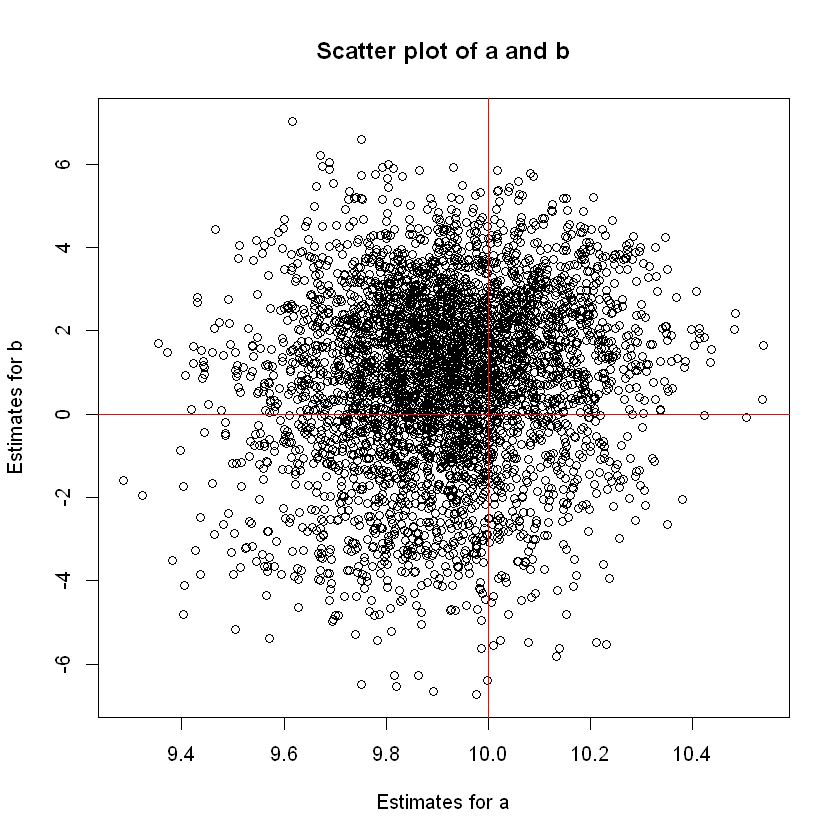

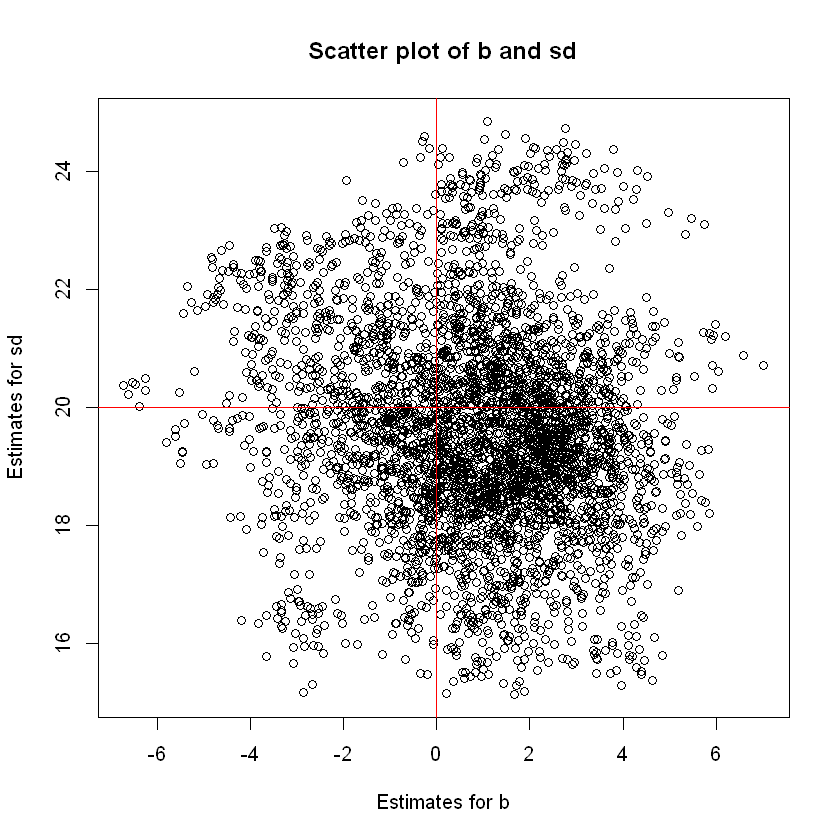

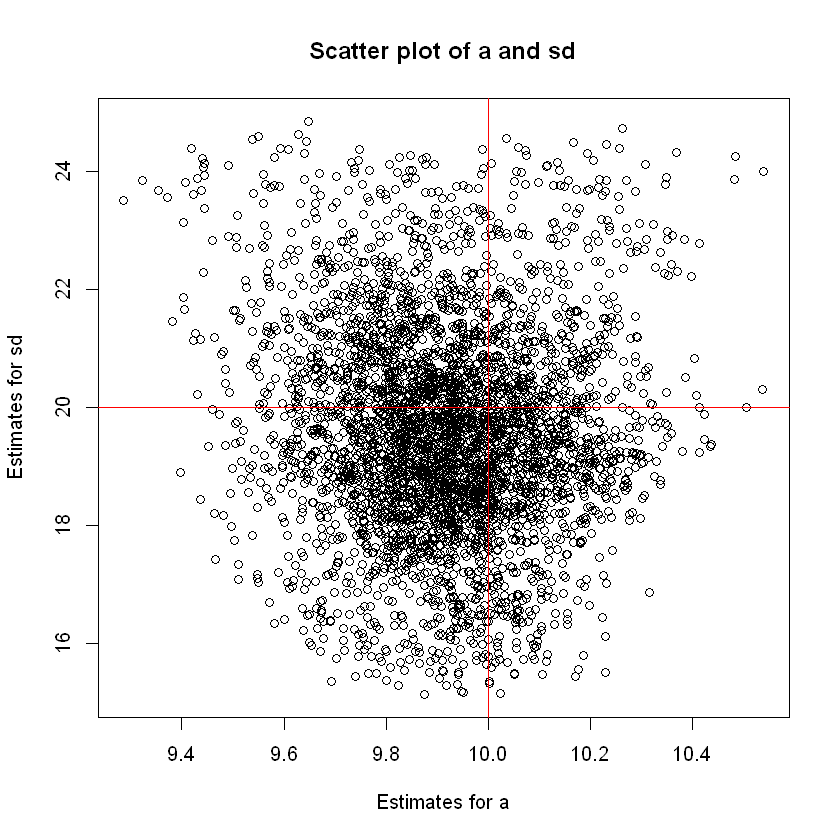

In [12]:
plot(chain[-(1:burnIn),1:2], main="Scatter plot of a and b",
xlab="Estimates for a", ylab="Estimates for b")
abline(v = t.A, col="red" )
abline(h = t.B, col="red" )
plot(chain[-(1:burnIn),2:3], main="Scatter plot of b and sd",
xlab="Estimates for b", ylab="Estimates for sd")
abline(v = t.B, col="red" )
abline(h = t.sd, col="red" )
plot(chain[-(1:burnIn),c(1,3)], main="Scatter plot of a and sd",
xlab="Estimates for a", ylab="Estimates for sd")
abline(v = t.A, col="red" )
abline(h = t.sd, col="red" )

In [13]:
summary(lm(y~x))


Call:
lm(formula = y ~ x)

Residuals:
    Min      1Q  Median      3Q     Max 
-33.067 -12.201  -3.733  14.562  46.192 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.4786     2.6115   0.183    0.855    
x             9.9082     0.1810  54.751   <2e-16 ***
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

Residual standard error: 18.47 on 48 degrees of freedom
Multiple R-squared:  0.9842,	Adjusted R-squared:  0.9839 
F-statistic:  2998 on 1 and 48 DF,  p-value: < 2.2e-16
